# Example

In [1]:
import numpy as np
import plotly.graph_objects as go
import pandas as pd

from pySPFM.deconvolution.hrf_generator import HRFMatrix
from pySPFM.deconvolution.lars import solve_regularization_path
import matplotlib.pyplot as plt

from myst_nb import glue

import plotly
plotly.offline.init_notebook_mode()

In [2]:
n_scans = 760
tr = 1

noise_level = 1.5

onsets = np.zeros(n_scans)

hrf_generator = HRFMatrix(te=[0], block=False)
hrf = hrf_generator.generate_hrf(tr=tr, n_scans=n_scans).hrf_

onsets = np.zeros(n_scans)
onsets[20:24] = 1
onsets[50:64] = 1
onsets[67:72] = 1
onsets[101:124] = 1
onsets[133:140] = 1
onsets[311:324] = 1
onsets[372:374] = 1
onsets[420:424] = 1
onsets[450:464] = 1
onsets[467:472] = 1
onsets[501:524] = 1
onsets[550:564] = 1
onsets[567:572] = 1
onsets[601:624] = 1
onsets[660:664] = 1
onsets[701:714] = 1
onsets[730:744] = 1

data_clean = np.dot(hrf, onsets)
data = data_clean + np.random.normal(0, noise_level, data_clean.shape)
data_spc = (data - np.mean(data))/np.mean(data)
data_spc = data_spc/np.sqrt(np.sum(data_spc**2, axis=0))

Text(87.125, 0.5, 'Amplitude (psc)')

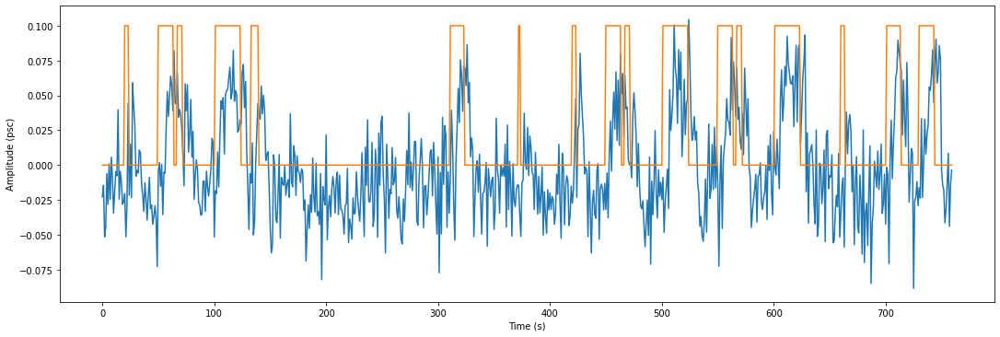

In [3]:
plt.figure(figsize=(15,5))
plt.plot(data_spc, label="Simulated")
plt.plot(onsets*0.1, label="Onsets")
plt.tight_layout()
plt.xlabel("Time (s)")
plt.ylabel("Amplitude (psc)")

In [4]:
_, lambda_opt, coef_path, lambdas = solve_regularization_path(hrf, data_spc, n_scans)

In [5]:
df = pd.DataFrame(coef_path)
df["Time"] = np.arange(0, n_scans, 1)
df["Lambdas"] = lambdas

In [6]:
df

,0,1,2,3,4,5,6,7,8,9,...,752,753,754,755,756,757,758,759,Time,Lambdas
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.042025,-0.042036,-0.042122,-0.042159,-0.042184,-0.042316,-0.042381,-0.042827,0,0.000506
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.031767,0.031778,0.031870,0.031911,0.031938,0.032080,0.032150,0.032630,1,0.000499
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2,0.000477
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3,0.000453
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4,0.000447
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
755,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.034268,0.034298,0.034552,0.034663,0.034737,0.035127,0.035319,0.036635,755,0.000003
756,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,756,0.000003
757,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,757,0.000003
758,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,758,0.000003


In [7]:
lambda_opt_id = np.where(lambdas == lambda_opt)[0][0]

In [8]:
lambda_opt_id

0

In [9]:
df_clean = pd.DataFrame()
df_clean["Data"] = data_clean*0.01
df_clean["Time"] = np.arange(0, n_scans, 1)

In [10]:
# Estimates figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0, n_scans, 1):
    fig.add_trace(
        go.Scatter(visible=False,
                   line=dict(color="blue", width=1),
                   name=f"Lambda = {lambdas[step]}",
                   x=np.arange(0, n_scans, 1),
                   y=coef_path[:, step]
                  )
    )
    
fig.data[lambda_opt_id].visible = True

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": f"Estimates with lambda = {lambdas[i]}"}],
    )
    step["args"][0]["visible"][i] = True # Toggle i'th trace to "visible"
    steps.append(step)
    
sliders = [dict(
    active = lambda_opt_id,
    currentvalue={"prefix": "Lambda: "},
    pad={"t": 50},
    steps=steps
)]


bold = go.Scatter(visible=True,
           line=dict(color="green", width=0.5),
           name="Simulated BOLD data",
           x=np.arange(0, n_scans, 1),
           y=data_clean*0.01
          )
fig.add_trace(bold)


# events = go.Scatter(visible=True,
#                line=dict(color="teal", width=0.5),
#                name="Simulated events",
#                x=np.arange(0, n_scans, 1),
#                y=onsets*0.05
#             )
# fig.add_trace(events)

fig.update_layout(
    sliders=sliders,
    xaxis=dict(title='Time (s)'),
    yaxis=dict(title='Amplitude'),
)

glue("regularization_figure", fig, display=False)
# fig.show()

In [12]:
fig.write_json("regularization_figure.json")